In [1]:
%cd ..
%ls

/home/nas3_userJ/dmkim/OnlineTSAD
cfgs/         EDA/      hptune/  outputs/  test.py*       utils/
checkpoints/  Exp/      logs/    plots/    thresholding/  Vis/
data/         figures/  models/  results/  train.py*      wandb/


In [2]:
import torch
from torch import optim
import torch.nn.functional as F

import matplotlib.pyplot as plt

from utils.metrics import get_summary_stats

from models.MLP import MLP

import wandb
import hydra
from omegaconf import DictConfig

from utils.logger import make_logger
from utils.argpass import prepare_arguments, configure_exp_id
from utils.tools import SEED_everything, plot_interval

import warnings
from data.load_data import DataFactory
from Exp.ReconBaselines import *

from easydict import EasyDict as edict
import yaml
import re
import copy

warnings.filterwarnings("ignore")

In [3]:
# load yaml
cfg = {}
loader = yaml.SafeLoader
loader.add_implicit_resolver(
    u'tag:yaml.org,2002:float',
    re.compile(u'''^(?:
     [-+]?(?:[0-9][0-9_]*)\\.[0-9_]*(?:[eE][-+]?[0-9]+)?
    |[-+]?(?:[0-9][0-9_]*)(?:[eE][-+]?[0-9]+)
    |\\.[0-9_]+(?:[eE][-+][0-9]+)?
    |[-+]?[0-9][0-9_]*(?::[0-5]?[0-9])+\\.[0-9_]*
    |[-+]?\\.(?:inf|Inf|INF)
    |\\.(?:nan|NaN|NAN))$''', re.X),
    list(u'-+0123456789.'))

# get cfg
model = "MLP"
with open("cfgs/test_defaults.yaml", "r") as file:
    basic_config = yaml.load(file, Loader=loader)
    cfg.update(basic_config)
with open(f"cfgs/model/{model}.yaml", "r") as file:
    model_config = yaml.load(file, Loader=loader)
    cfg.update({"model": model_config})
cfg['dataset'] = 'SWaT'
cfg["normalization"] = 'SlowRevIN'
cfg["gamma"] = 0.9999

In [4]:
args = prepare_arguments(cfg)
args.model.latent_dim = 128
args.window_size = 12
args.eval_batch_size = 1
args.dataset = "SWaT"
print(args)

logger = make_logger(os.path.join(args.log_path, f'{args.exp_id}.log'))
logger.info(f"Configurations: {args}")

# Data
logger.info(f"Preparing {args.dataset} dataset...")
datafactory = DataFactory(args, logger)
train_dataset, train_loader, test_dataset, test_loader = datafactory()
args.num_channels = train_dataset.X.shape[1]
train_X, train_y, test_X, test_y = train_dataset.X, train_dataset.y, test_dataset.X, test_dataset.y

print(train_X.shape, train_y.shape, test_X.shape, test_y.shape)

[2023-04-23 04:00:51,520] Configurations: {'exp_id': 'MLP_SWaT_normalization_SlowRevIN', 'infer_options': ['offline_all'], 'qStart': 0.9, 'qEnd': 1.0, 'qStep': 0.01, 'dataset': 'SWaT', 'batch_size': 64, 'eval_batch_size': 1, 'window_size': 12, 'stride': 1, 'eval_stride': 12, 'scaler': 'std', 'load_previous_error': True, 'lr': 0.001, 'epochs': 30, 'TT_loss': 'bce', 'cls_lambda': 1, 'ttlr': 0.001, 'thlr': 0.001, 'normalization': 'SlowRevIN', 'gamma': 0.9999, 'log_freq': 10, 'checkpoint_path': './checkpoints/MLP_SWaT_normalization_SlowRevIN', 'log_path': './logs/MLP_SWaT_normalization_SlowRevIN', 'output_path': './outputs/MLP_SWaT_normalization_SlowRevIN', 'plot_path': './plots/MLP_SWaT_normalization_SlowRevIN', 'result_path': './results/MLP_SWaT_normalization_SlowRevIN', 'plot_anomaly_scores': True, 'plot_recon_status': False, 'defaults': [{'model': 'MLP'}], 'model': {'name': 'MLP', 'latent_dim': 128}, 'home_dir': '.', 'device': device(type='cuda')}
[2023-04-23 04:00:51,522] Preparing SW

{'exp_id': 'MLP_SWaT_normalization_SlowRevIN', 'infer_options': ['offline_all'], 'qStart': 0.9, 'qEnd': 1.0, 'qStep': 0.01, 'dataset': 'SWaT', 'batch_size': 64, 'eval_batch_size': 1, 'window_size': 12, 'stride': 1, 'eval_stride': 12, 'scaler': 'std', 'load_previous_error': True, 'lr': 0.001, 'epochs': 30, 'TT_loss': 'bce', 'cls_lambda': 1, 'ttlr': 0.001, 'thlr': 0.001, 'normalization': 'SlowRevIN', 'gamma': 0.9999, 'log_freq': 10, 'checkpoint_path': './checkpoints/MLP_SWaT_normalization_SlowRevIN', 'log_path': './logs/MLP_SWaT_normalization_SlowRevIN', 'output_path': './outputs/MLP_SWaT_normalization_SlowRevIN', 'plot_path': './plots/MLP_SWaT_normalization_SlowRevIN', 'result_path': './results/MLP_SWaT_normalization_SlowRevIN', 'plot_anomaly_scores': True, 'plot_recon_status': False, 'defaults': [{'model': 'MLP'}], 'model': {'name': 'MLP', 'latent_dim': 128}, 'home_dir': '.', 'device': device(type='cuda')}


[2023-04-23 04:00:58,180] train: X - (496800, 51), y - (496800,) test: X - (449919, 51), y - (449919,)
[2023-04-23 04:00:58,252] Complete.
[2023-04-23 04:00:58,253] Preparing dataloader...
[2023-04-23 04:00:58,714] total train dataset- 7763, batch_X - torch.Size([64, 12, 51]), batch_y - torch.Size([64, 12])
[2023-04-23 04:00:58,716] total test dataset- 37493, batch_X - torch.Size([1, 12, 51]), batch_y - torch.Size([1, 12])
[2023-04-23 04:00:58,716] Complete.


(496800, 51) (496800,) (449916, 51) (449916,)


## Visualize

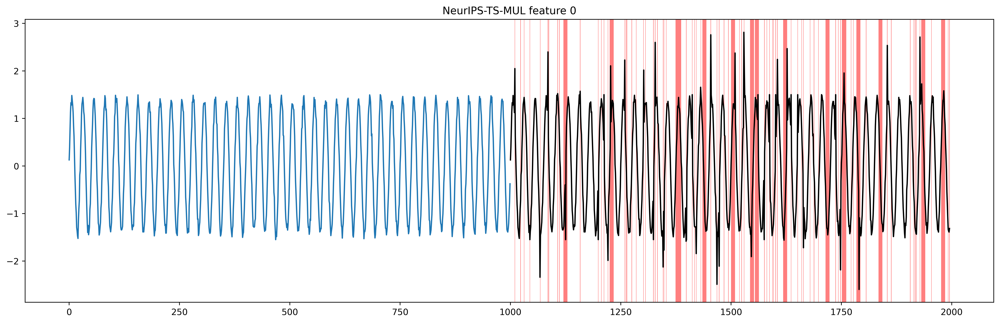

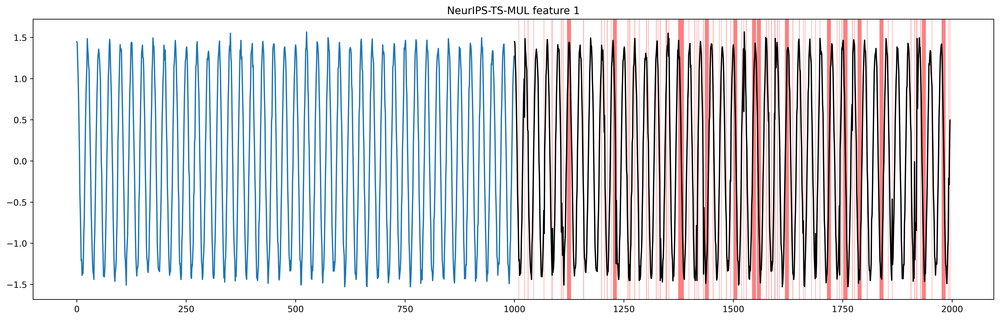

KeyboardInterrupt: 

In [22]:
for c in range(args.num_channels):
    dataset_name = "SWaT"
    plt.figure(figsize=(20, 6), dpi=500)
    plt.plot(train_X[:, c], color="C0")
    plt.plot(range(len(train_X), len(train_X)+len(test_X)), test_X[:, c], color="black")
    label = np.concatenate([np.array([0]*len(train_X)), test_y])
    plot_interval(plt, label)
    plt.title(f"{dataset_name} feature {c}")
    plt.show()

## Load Model

In [5]:
tester = MLP_Tester(
    args=args,
    logger=logger,
    train_loader=train_loader,
    test_loader=test_loader,
)
tester.load(os.path.join("./checkpoints/MLP_SWaT_normalization_SlowRevIN", f"best.pth"))

[2023-04-23 04:01:01,719] loading: ./checkpoints/MLP_SWaT_normalization_SlowRevIN/best.pth @Trainer - torch.load_state_dict
[2023-04-23 04:01:01,726] train_errors.pt file exists, loading...
[2023-04-23 04:01:01,740] torch.Size([496789, 12])
[2023-04-23 04:01:01,742] test_errors.pt file exists, loading...
[2023-04-23 04:01:01,744] torch.Size([37493, 12])
[2023-04-23 04:01:02,001] loading: ./checkpoints/MLP_SWaT_normalization_SlowRevIN/best.pth @Trainer - torch.load_state_dict


In [6]:
next(iter(tester.model.parameters())).device, next(iter(tester.model.parameters())).requires_grad

(device(type='cuda', index=0), True)

In [7]:
tester.model.state_dict()

OrderedDict([('encoder.linear1.weight',
              tensor([[-1.2468e-01, -1.8314e-02,  1.5372e-02,  ...,  4.7431e-03,
                        8.5309e-02,  9.3044e-03],
                      [-1.4695e-02,  4.1584e-02,  9.7379e-02,  ...,  2.8408e-02,
                       -4.3038e-02,  2.1300e-02],
                      [ 5.1359e-02,  5.2910e-02,  1.7119e-01,  ..., -2.2359e-06,
                        6.2751e-02,  6.7766e-03],
                      ...,
                      [-2.1934e-02, -7.5381e-02, -2.2587e-02,  ..., -2.6376e-02,
                        1.3158e-03, -5.5790e-03],
                      [-4.0750e-02, -3.0460e-02,  1.8919e-01,  ...,  3.3043e-02,
                       -3.7060e-02,  2.4957e-02],
                      [-1.0605e-01,  1.6111e-02, -2.9359e-01,  ..., -3.0857e-02,
                        4.0601e-04,  2.0290e-02]], device='cuda:0')),
             ('encoder.linear1.bias',
              tensor([-0.8654, -1.4974, -1.7906, -0.5806, -1.8157, -2.4185, -2.3293, -1.0

## Training statistics

In [8]:
train_iterator = tqdm(
    tester.train_loader,
    total=len(tester.train_loader),
    desc="calculating reconstruction errors",
    leave=True
)

recon_errors = []
with torch.no_grad():
    for i, batch_data in enumerate(train_iterator):
        X = batch_data[0].to(args.device)
        B, L, C = X.shape
        Xhat = tester.model(X)
        recon_error = torch.nn.functional.mse_loss(Xhat, X, reduction='none')
        recon_errors.append(recon_error)

recon_errors = torch.cat(recon_errors, axis=0)

train_error_dist = recon_errors.mean(dim=(1, 2))

print(f"{recon_errors.shape}, {train_error_dist.shape}")

calculating reconstruction errors: 100%|██████████| 7763/7763 [00:09<00:00, 809.06it/s]

torch.Size([496789, 12, 51]), torch.Size([496789])


In [9]:
train_error_dist.shape

torch.Size([496789])

In [10]:
th_q95 = torch.quantile(train_error_dist, 0.95).item()
th_q95

0.011601502075791359

## Test: static threshold inference

In [21]:
eval_iterator = tqdm(
    tester.test_loader,
    total=len(tester.test_loader),
    desc="calculating reconstruction errors",
    leave=True
)

anoscs_prev = []
Xhats_prev = []
with torch.no_grad():
    for i, batch_data in enumerate(eval_iterator):
        X, y = batch_data[0].to(args.device), batch_data[1].to(args.device)
        B, L, C = X.shape
        Xhat = tester.model(X)
        Xhats_prev.append(Xhat)        
        e = F.mse_loss(Xhat, X, reduction='none')
        anosc = e.mean(dim=2)
        anoscs_prev.append(anosc)

Xhats_prev = torch.cat(Xhats_prev, axis=0).detach().cpu().numpy()
anoscs_prev = torch.cat(anoscs_prev, axis=0).reshape(-1).detach().cpu().numpy()

calculating reconstruction errors: 100%|██████████| 37493/37493 [00:23<00:00, 1624.34it/s]


In [22]:
th_q95 = torch.quantile(train_error_dist, 0.95).item()
th_q99 = torch.quantile(train_error_dist, 0.99).item()
th_q100 = torch.max(train_error_dist).item()
th_best_static = get_best_static_threshold(gt=test_y, anomaly_scores=anoscs_prev)
th_q95, th_q99, th_q100, th_best_static

(0.011601502075791359, 0.05172734707593918, 6.641019821166992, 7.5880322)

In [23]:
# 95
print(get_summary_stats(test_dataset.y, anoscs_prev > th_q95))
# 99
print(get_summary_stats(test_dataset.y, anoscs_prev > th_q99))
# 100
print(get_summary_stats(test_dataset.y, anoscs_prev > th_q100))
# oracle
print(get_summary_stats(test_dataset.y, anoscs_prev > th_best_static))

# oracle
print(get_summary_stats(test_dataset.y, anoscs_prev > max_icvar_th))

{'Accuracy': 0.29302580926217336, 'Precision': 0.14283777885613747, 'Recall': 0.9652828667741463, 'F1': 0.24885171339710993, 'tn': 79148, 'fp': 316184, 'fn': 1895, 'tp': 52689, 'Accuracy_PA': 0.2958530036717965, 'Precision_PA': 0.14578340920450095, 'Recall_PA': 0.9885863989447458, 'F1_PA': 0.25409614130421987, 'tn_PA': 79148, 'fp_PA': 316184, 'fn_PA': 623, 'tp_PA': 53961}
{'Accuracy': 0.33790752051494055, 'Precision': 0.14881959319411325, 'Recall': 0.944452586838634, 'F1': 0.2571236190428689, 'tn': 100478, 'fp': 294854, 'fn': 3032, 'tp': 51552, 'Accuracy_PA': 0.34165933196418885, 'Precision_PA': 0.15294719242503463, 'Recall_PA': 0.9753773999706874, 'F1_PA': 0.264429643536523, 'tn_PA': 100478, 'fp_PA': 294854, 'fn_PA': 1344, 'tp_PA': 53240}
{'Accuracy': 0.9471456894175801, 'Precision': 0.9048895899053627, 'Recall': 0.6306243587864576, 'F1': 0.7432630851615133, 'tn': 391714, 'fp': 3618, 'fn': 20162, 'tp': 34422, 'Accuracy_PA': 0.9634065025471421, 'Precision_PA': 0.9202310609401182, 'Reca

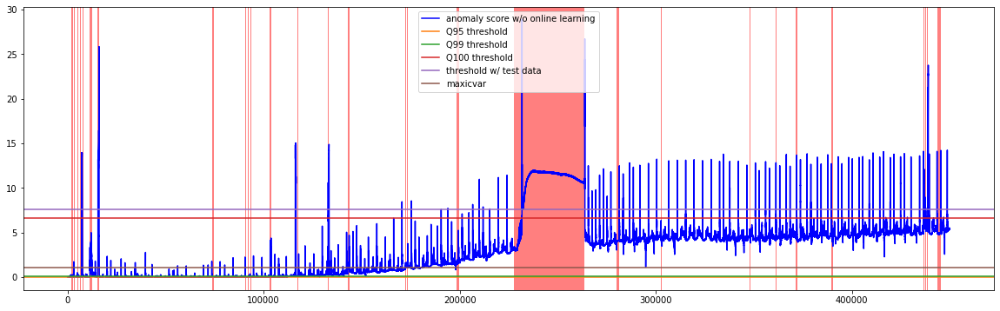

In [49]:
plt.figure(figsize=(20, 6))
#lt.ylim([-2, 5])
plt.plot(anoscs_prev, color="blue", label="anomaly score w/o online learning")
#plt.plot(anoscs, color="green", label="anomaly score w/ online learning")
plt.axhline(th_q95, color="C1", label="Q95 threshold")
plt.axhline(th_q99, color="C2", label="Q99 threshold")
plt.axhline(th_q100, color="C3", label="Q100 threshold")
plt.axhline(th_best_static, color="C4", label="threshold w/ test data")
plt.axhline(max_icvar_th, color="C5", label="maxicvar")


#plt.plot(thrs, color="gold",label="dynamic threshold")
plt.legend()
plot_interval(plt, test_y)
plt.show()

## Otsu

In [15]:
train_errors = train_error_dist.detach().cpu().numpy()
train_errors.shape

(496789,)

In [16]:
max_icvar_th = 0
max_icvar = 0
for i in np.arange(0.01, 17, 0.01):
    c1 = train_errors[train_errors<i] # normal
    c2 = train_errors[train_errors>i] # abnormal
    p1, p2 = len(c1)/len(train_errors), len(c2)/len(train_errors)
    m1, m2 = c1.mean(), c2.mean()
    
    icvar = (p1*p2*(m1-m2)**2)
    if icvar> max_icvar:
        max_icvar = icvar
        max_icvar_th = i

print(max_icvar_th)

1.07


181 496608 0.00036433979013222916


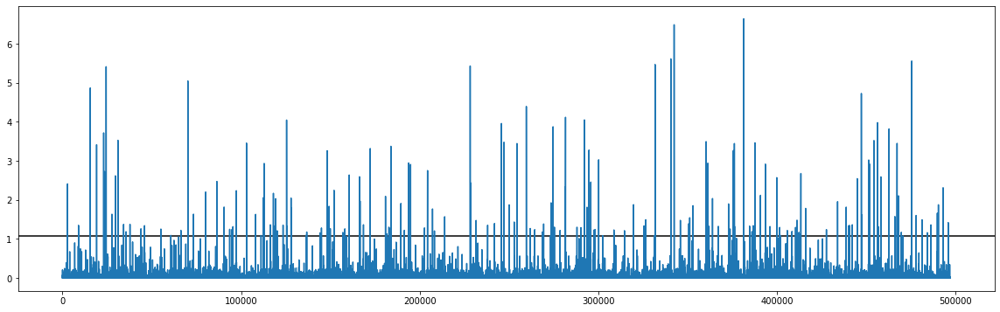

In [19]:
plt.figure(figsize=(20, 6))
plt.axhline(max_icvar_th, color="black")
plt.plot(train_errors)
print((train_errors>max_icvar_th).sum(), (train_errors<max_icvar_th).sum(), (train_errors>max_icvar_th).sum()/len(train_errors))

In [26]:
# 95
print(get_summary_stats(test_dataset.y, anoscs_prev > th_q95))
# 99
print(get_summary_stats(test_dataset.y, anoscs_prev > th_q99))
# 100
print(get_summary_stats(test_dataset.y, anoscs_prev > th_q100))
# oracle
print(get_summary_stats(test_dataset.y, anoscs_prev > th_best_static))

# oracle
print(get_summary_stats(test_dataset.y, anoscs_prev > max_icvar_th))

{'Accuracy': 0.29302580926217336, 'Precision': 0.14283777885613747, 'Recall': 0.9652828667741463, 'F1': 0.24885171339710993, 'tn': 79148, 'fp': 316184, 'fn': 1895, 'tp': 52689, 'Accuracy_PA': 0.2958530036717965, 'Precision_PA': 0.14578340920450095, 'Recall_PA': 0.9885863989447458, 'F1_PA': 0.25409614130421987, 'tn_PA': 79148, 'fp_PA': 316184, 'fn_PA': 623, 'tp_PA': 53961}
{'Accuracy': 0.33790752051494055, 'Precision': 0.14881959319411325, 'Recall': 0.944452586838634, 'F1': 0.2571236190428689, 'tn': 100478, 'fp': 294854, 'fn': 3032, 'tp': 51552, 'Accuracy_PA': 0.34165933196418885, 'Precision_PA': 0.15294719242503463, 'Recall_PA': 0.9753773999706874, 'F1_PA': 0.264429643536523, 'tn_PA': 100478, 'fp_PA': 294854, 'fn_PA': 1344, 'tp_PA': 53240}
{'Accuracy': 0.9471456894175801, 'Precision': 0.9048895899053627, 'Recall': 0.6306243587864576, 'F1': 0.7432630851615133, 'tn': 391714, 'fp': 3618, 'fn': 20162, 'tp': 34422, 'Accuracy_PA': 0.9634065025471421, 'Precision_PA': 0.9202310609401182, 'Reca

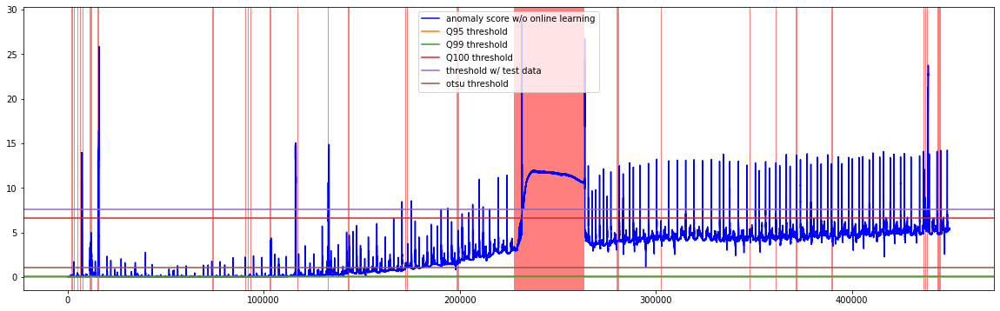

In [27]:
plt.figure(figsize=(20, 6))
#lt.ylim([-2, 5])
plt.plot(anoscs_prev, color="blue", label="anomaly score w/o online learning")
#plt.plot(anoscs, color="green", label="anomaly score w/ online learning")
plt.axhline(th_q95, color="C1", label="Q95 threshold")
plt.axhline(th_q99, color="C2", label="Q99 threshold")
plt.axhline(th_q100, color="C3", label="Q100 threshold")
plt.axhline(th_best_static, color="C4", label="threshold w/ test data")
plt.axhline(max_icvar_th, color="C5", label="otsu threshold")
#plt.plot(thrs, color="gold",label="dynamic threshold")
plt.legend()
plot_interval(plt, test_y)
plt.show()

## POT + Otsu

In [65]:
from thresholding.pot import pot
from thresholding.grimshaw import grimshaw

In [66]:
(train_errors>max_icvar_th).sum()/len(train_errors)

0.00036433979013222916

In [77]:
risk = (train_errors>max_icvar_th).sum()/len(train_errors)
init_level = 0.99
num_candidates = 10
epsilon = 1e-8

In [78]:
z, t = pot(train_errors, risk, init_level, num_candidates, epsilon)
z, t

(0.5791278182785506, 0.051730752)

In [79]:
train_errors.shape

(496789,)

181 496608 0.00036433979013222916


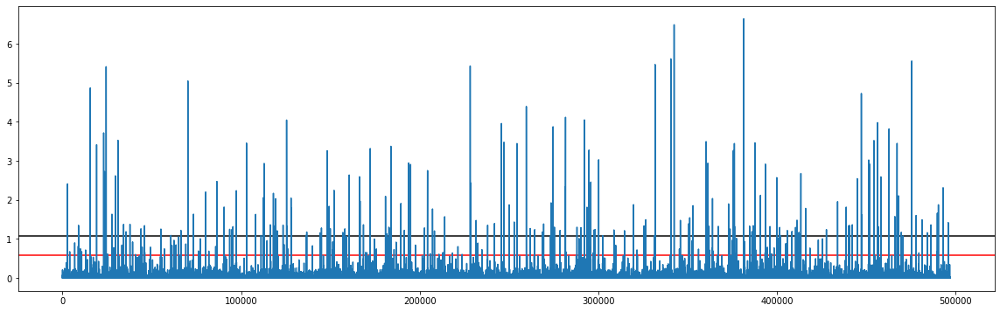

In [80]:
plt.figure(figsize=(20, 6))
plt.axhline(max_icvar_th, color="black")
plt.axhline(z, color="red")
plt.plot(train_errors)
print((train_errors>max_icvar_th).sum(), (train_errors<max_icvar_th).sum(), (train_errors>max_icvar_th).sum()/len(train_errors))

In [35]:
# 95
print(get_summary_stats(test_dataset.y, anoscs_prev > th_q95))
# 99
print(get_summary_stats(test_dataset.y, anoscs_prev > th_q99))
# 100
print(get_summary_stats(test_dataset.y, anoscs_prev > th_q100))
# oracle
print(get_summary_stats(test_dataset.y, anoscs_prev > th_best_static))

# otsu
print(get_summary_stats(test_dataset.y, anoscs_prev > max_icvar_th))

# otsu + POT
print(get_summary_stats(test_dataset.y, anoscs_prev > z))

{'Accuracy': 0.29302580926217336, 'Precision': 0.14283777885613747, 'Recall': 0.9652828667741463, 'F1': 0.24885171339710993, 'tn': 79148, 'fp': 316184, 'fn': 1895, 'tp': 52689, 'Accuracy_PA': 0.2958530036717965, 'Precision_PA': 0.14578340920450095, 'Recall_PA': 0.9885863989447458, 'F1_PA': 0.25409614130421987, 'tn_PA': 79148, 'fp_PA': 316184, 'fn_PA': 623, 'tp_PA': 53961}
{'Accuracy': 0.33790752051494055, 'Precision': 0.14881959319411325, 'Recall': 0.944452586838634, 'F1': 0.2571236190428689, 'tn': 100478, 'fp': 294854, 'fn': 3032, 'tp': 51552, 'Accuracy_PA': 0.34165933196418885, 'Precision_PA': 0.15294719242503463, 'Recall_PA': 0.9753773999706874, 'F1_PA': 0.264429643536523, 'tn_PA': 100478, 'fp_PA': 294854, 'fn_PA': 1344, 'tp_PA': 53240}
{'Accuracy': 0.9471456894175801, 'Precision': 0.9048895899053627, 'Recall': 0.6306243587864576, 'F1': 0.7432630851615133, 'tn': 391714, 'fp': 3618, 'fn': 20162, 'tp': 34422, 'Accuracy_PA': 0.9634065025471421, 'Precision_PA': 0.9202310609401182, 'Reca

## Otsu + online learning

In [42]:
tester = MLP_Tester(
    args=args,
    logger=logger,
    train_loader=train_loader,
    test_loader=test_loader,
)
tester.load(os.path.join("./checkpoints/MLP_SWaT_normalization_SlowRevIN", f"best.pth"))

tester.model.normalizer.gamma = 0.99999

[2023-04-23 04:23:09,811] loading: ./checkpoints/MLP_SWaT_normalization_SlowRevIN/best.pth @Trainer - torch.load_state_dict
[2023-04-23 04:23:09,817] train_errors.pt file exists, loading...
[2023-04-23 04:23:09,829] torch.Size([496789, 12])
[2023-04-23 04:23:09,840] test_errors.pt file exists, loading...
[2023-04-23 04:23:09,842] torch.Size([37493, 12])
[2023-04-23 04:23:10,076] loading: ./checkpoints/MLP_SWaT_normalization_SlowRevIN/best.pth @Trainer - torch.load_state_dict


calculating reconstruction errors: 100%|██████████| 37493/37493 [02:04<00:00, 302.05it/s]


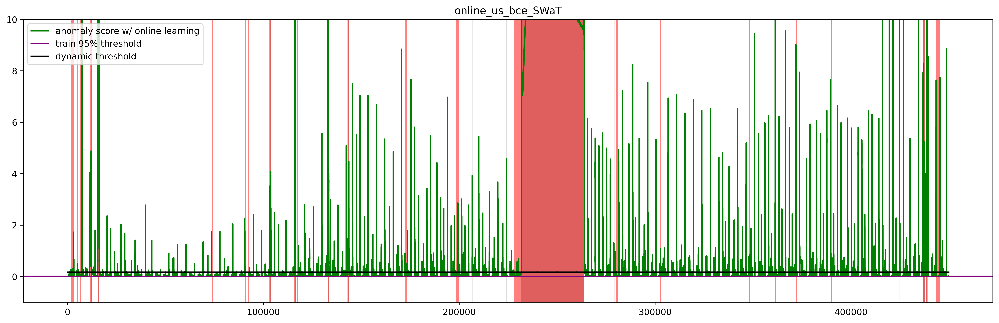

In [43]:
eval_iterator = tqdm(
    tester.test_loader,
    total=len(tester.test_loader),
    desc="calculating reconstruction errors",
    leave=True
)

lr = 1e-03
TT_optimizer = torch.optim.SGD([p for p in tester.model.parameters()], lr=lr)
tau = max_icvar_th

Xs, Xhats = [], []
yhats = []
preds = []
As, thrs =[], []

normals_As = []
anormals_As = []

for i, batch_data in enumerate(eval_iterator):
    X, y = batch_data[0].to(tester.args.device), batch_data[1].to(tester.args.device)
    B, L, C = X.shape
    
    # inference
    tester.model.normalizer._update_statistics(X)
    Xhat = tester.model(X)
    E = F.mse_loss(Xhat, X, reduction='none')
    A = E.mean(dim=2)
    
    ytilde = (A > tau).float()
    pred = (A > tau)
    
    # log source model outputs
    Xs.append(X)
    Xhats.append(Xhat.clone().detach())
    As.append(A.clone().detach())
    preds.append(pred.clone().detach())
    thrs.append(z)
    
    normals_As.append(torch.masked_select(A, ytilde==0))
    anormals_As.append(torch.masked_select(A, ytilde==1))
    
    
    # learn new-normals
    TT_optimizer.zero_grad()
    mask = (ytilde == 0)
    recon_loss = (A*mask).mean()
    recon_loss.backward()
    TT_optimizer.step()
    
    
    
Xs = torch.cat(Xs, axis=0).detach().cpu().numpy()    
Xhats = torch.cat(Xhats, axis=0).detach().cpu().numpy()

anoscs = torch.cat(As, axis=0).reshape(-1).detach().cpu().numpy()
thrs = np.repeat(np.array(thrs), args.window_size*args.eval_batch_size)
preds = torch.cat(preds).reshape(-1).detach().cpu().numpy()

normals_As = torch.cat(normals_As, axis=0).detach().cpu().numpy()
anormals_As = torch.cat(anormals_As, axis=0).detach().cpu().numpy()

s, e = 0, -1
plt.figure(figsize=(20, 6), dpi=500)
plt.title(f"online_us_bce_{args.dataset}")
plt.ylim([-1, 10])
#plt.plot(anoscs_prev[s:e], color="blue", label="anomaly score w/o online learning")
plt.plot(anoscs[s:e], color="green", label="anomaly score w/ online learning")
plt.axhline(th_q95, color="purple", label="train 95% threshold")
plt.plot(thrs[s:e], color="black",label="dynamic threshold")

plot_interval(plt, preds.astype(int)[s:e], facecolor="gray", alpha=0.5)
plot_interval(plt, test_y[s:e])
plt.legend()
plt.show()

In [44]:
print(test_y.shape, preds.shape)
single_CE = get_summary_stats(test_y, preds)
print(single_CE)

(449916,) (449916,)
{'Accuracy': 0.9541114341343717, 'Precision': 0.9309258977093808, 'Recall': 0.6715887439542723, 'F1': 0.7802728762691301, 'tn': 392612, 'fp': 2720, 'fn': 17926, 'tp': 36658, 'Accuracy_PA': 0.9770601623414148, 'Precision_PA': 0.9452749331026297, 'Recall_PA': 0.8607467389711271, 'F1_PA': 0.9010327269937768, 'tn_PA': 392612, 'fp_PA': 2720, 'fn_PA': 7601, 'tp_PA': 46983}


## otsu + pot base

In [45]:
tester = MLP_Tester(
    args=args,
    logger=logger,
    train_loader=train_loader,
    test_loader=test_loader,
)
tester.load(os.path.join("./checkpoints/MLP_SWaT_normalization_SlowRevIN", f"best.pth"))

tester.model.normalizer.gamma = 0.99999

[2023-04-23 04:25:23,584] loading: ./checkpoints/MLP_SWaT_normalization_SlowRevIN/best.pth @Trainer - torch.load_state_dict
[2023-04-23 04:25:23,596] train_errors.pt file exists, loading...
[2023-04-23 04:25:23,609] torch.Size([496789, 12])
[2023-04-23 04:25:23,624] test_errors.pt file exists, loading...
[2023-04-23 04:25:23,628] torch.Size([37493, 12])
[2023-04-23 04:25:23,881] loading: ./checkpoints/MLP_SWaT_normalization_SlowRevIN/best.pth @Trainer - torch.load_state_dict


calculating reconstruction errors: 100%|██████████| 37493/37493 [02:02<00:00, 304.94it/s]


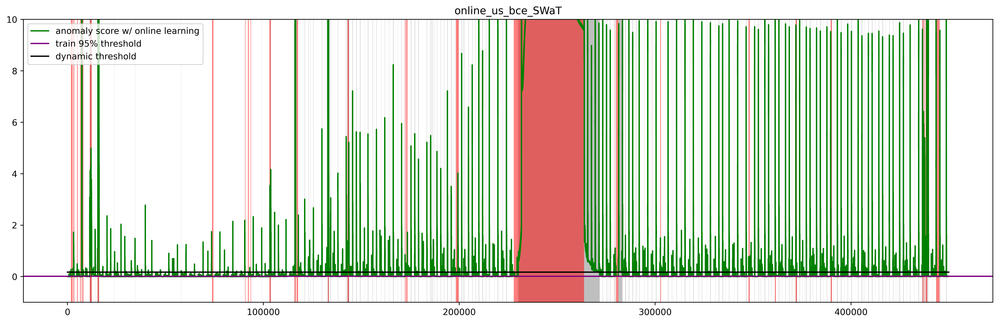

In [46]:
eval_iterator = tqdm(
    tester.test_loader,
    total=len(tester.test_loader),
    desc="calculating reconstruction errors",
    leave=True
)

lr = 1e-03
TT_optimizer = torch.optim.SGD([p for p in tester.model.parameters()], lr=lr)
tau = z

Xs, Xhats = [], []
yhats = []
preds = []
As, thrs =[], []

normals_As = []
anormals_As = []

for i, batch_data in enumerate(eval_iterator):
    X, y = batch_data[0].to(tester.args.device), batch_data[1].to(tester.args.device)
    B, L, C = X.shape
    
    # inference
    tester.model.normalizer._update_statistics(X)
    Xhat = tester.model(X)
    E = F.mse_loss(Xhat, X, reduction='none')
    A = E.mean(dim=2)
    
    ytilde = (A > tau).float()
    pred = (A > tau)
    
    # log source model outputs
    Xs.append(X)
    Xhats.append(Xhat.clone().detach())
    As.append(A.clone().detach())
    preds.append(pred.clone().detach())
    thrs.append(z)
    
    normals_As.append(torch.masked_select(A, ytilde==0))
    anormals_As.append(torch.masked_select(A, ytilde==1))
    
    
    # learn new-normals
    TT_optimizer.zero_grad()
    mask = (ytilde == 0)
    recon_loss = (A*mask).mean()
    recon_loss.backward()
    TT_optimizer.step()
    
    
    
Xs = torch.cat(Xs, axis=0).detach().cpu().numpy()    
Xhats = torch.cat(Xhats, axis=0).detach().cpu().numpy()

anoscs = torch.cat(As, axis=0).reshape(-1).detach().cpu().numpy()
thrs = np.repeat(np.array(thrs), args.window_size*args.eval_batch_size)
preds = torch.cat(preds).reshape(-1).detach().cpu().numpy()

normals_As = torch.cat(normals_As, axis=0).detach().cpu().numpy()
anormals_As = torch.cat(anormals_As, axis=0).detach().cpu().numpy()

s, e = 0, -1
plt.figure(figsize=(20, 6), dpi=500)
plt.title(f"online_us_bce_{args.dataset}")
plt.ylim([-1, 10])
#plt.plot(anoscs_prev[s:e], color="blue", label="anomaly score w/o online learning")
plt.plot(anoscs[s:e], color="green", label="anomaly score w/ online learning")
plt.axhline(th_q95, color="purple", label="train 95% threshold")
plt.plot(thrs[s:e], color="black",label="dynamic threshold")

plot_interval(plt, preds.astype(int)[s:e], facecolor="gray", alpha=0.5)
plot_interval(plt, test_y[s:e])
plt.legend()
plt.show()

In [47]:
print(test_y.shape, preds.shape)
single_CE = get_summary_stats(test_y, preds)
print(single_CE)

(449916,) (449916,)
{'Accuracy': 0.8982365597133687, 'Precision': 0.5613675356739339, 'Recall': 0.7373039718598857, 'F1': 0.6374183330033657, 'tn': 363886, 'fp': 31446, 'fn': 14339, 'tp': 40245, 'Accuracy_PA': 0.9244103343735275, 'Precision_PA': 0.623252303305498, 'Recall_PA': 0.9530448483071963, 'F1_PA': 0.7536490137702733, 'tn_PA': 363886, 'fp_PA': 31446, 'fn_PA': 2563, 'tp_PA': 52021}


## Value-based Pseudo-label guided Online Learning (separate threshold)

### 1. Single+CE

In [237]:
tester = MLP_Tester(
    args=args,
    logger=logger,
    train_loader=train_loader,
    test_loader=test_loader,
)
tester.load(os.path.join("./checkpoints/MLP_SWaT_normalization_ARevIN", f"best.pth"))

[2023-04-21 03:40:19,630] loading: ./checkpoints/MLP_SWaT_normalization_ARevIN/best.pth @Trainer - torch.load_state_dict
[2023-04-21 03:40:19,642] train_errors.pt file exists, loading...
[2023-04-21 03:40:19,660] torch.Size([496789, 12])
[2023-04-21 03:40:19,672] test_errors.pt file exists, loading...
[2023-04-21 03:40:19,674] torch.Size([37493, 12])
[2023-04-21 03:40:19,934] loading: ./checkpoints/MLP_SWaT_normalization_ARevIN/best.pth @Trainer - torch.load_state_dict


In [238]:
tester.model.revin.gamma = 0.99999
tester.model.revin.gamma

0.99999

In [239]:
from thresholding.spot import spot
from thresholding.grimshaw import grimshaw

In [240]:
peaks = train_errors[train_errors>t] - t
peaks.shape

(24839,)

In [241]:
total = len(train_errors)
total

496789

In [242]:
k = len(peaks)

In [243]:
z, t, k, total

(0.82105978545396, 0.013887135, 24839, 496789)

In [248]:
z = t = th_q95
k = total = 0
z, t, k, total

(0.013887092471122742, 0.013887092471122742, 0, 0)

In [244]:
eval_iterator = tqdm(
    tester.test_loader,
    total=len(tester.test_loader),
    desc="calculating reconstruction errors",
    leave=True
)

lr = 1e-03
TT_optimizer = torch.optim.SGD([p for p in tester.model.parameters()], lr=lr)
bce = torch.nn.BCELoss()

Xs, Xhats = [], []
yhats = []
preds = []
As, thrs =[], []

normals_As = []
anormals_As = []

for i, batch_data in enumerate(eval_iterator):
    X, y = batch_data[0].to(tester.args.device), batch_data[1].to(tester.args.device)
    B, L, C = X.shape
    
    # inference
    tester.model.revin._update_statistics(X)
    Xhat = tester.model(X)
    E = F.mse_loss(Xhat, X, reduction='none')
    A = E.mean(dim=2)
    
    ytilde = (A > z).float()
    pred = (A > z)
    
    # update peak statistics.
    total += L
    is_peak = (t < A) * (A < z)
    if is_peak.sum() > 0:
        k += (is_peak).sum()
        new_peak = A.masked_select(is_peak).detach().cpu().numpy() - t
        peaks = np.concatenate([peaks, new_peak])
        gam, sig = grimshaw(peaks=peaks, threshold=t)
        r = total * risk / peaks.size
        z = t + (sig/gam) * (pow(r, -gam) - 1)
    
    
    # log source model outputs
    Xs.append(X)
    Xhats.append(Xhat.clone().detach())
    As.append(A.clone().detach())
    preds.append(pred.clone().detach())
    thrs.append(z)
    
    normals_As.append(torch.masked_select(A, ytilde==0))
    anormals_As.append(torch.masked_select(A, ytilde==1))
    
    
    # learn new-normals
    TT_optimizer.zero_grad()
    mask = (ytilde == 0)
    recon_loss = (A*mask).mean()
    recon_loss.backward()
    TT_optimizer.step()
    
    
    
Xs = torch.cat(Xs, axis=0).detach().cpu().numpy()    
Xhats = torch.cat(Xhats, axis=0).detach().cpu().numpy()

anoscs = torch.cat(As, axis=0).reshape(-1).detach().cpu().numpy()
thrs = np.repeat(np.array(thrs), args.window_size*args.eval_batch_size)
preds = torch.cat(preds).reshape(-1).detach().cpu().numpy()

normals_As = torch.cat(normals_As, axis=0).detach().cpu().numpy()
anormals_As = torch.cat(anormals_As, axis=0).detach().cpu().numpy()


print(test_y.shape, preds.shape)
single_CE = get_summary_stats(test_y, preds)
print(single_CE)

calculating reconstruction errors: 100%|██████████| 37493/37493 [09:44<00:00, 64.16it/s] 


In [245]:
print(test_y.shape, preds.shape)
single_CE = get_summary_stats(test_y, preds)
print(single_CE)

(449916,) (449916,)
{'Accuracy': 0.9386774420113977, 'Precision': 0.7845067453625633, 'Recall': 0.681829840246226, 'F1': 0.7295734337018741, 'tn': 385109, 'fp': 10223, 'fn': 17367, 'tp': 37217}


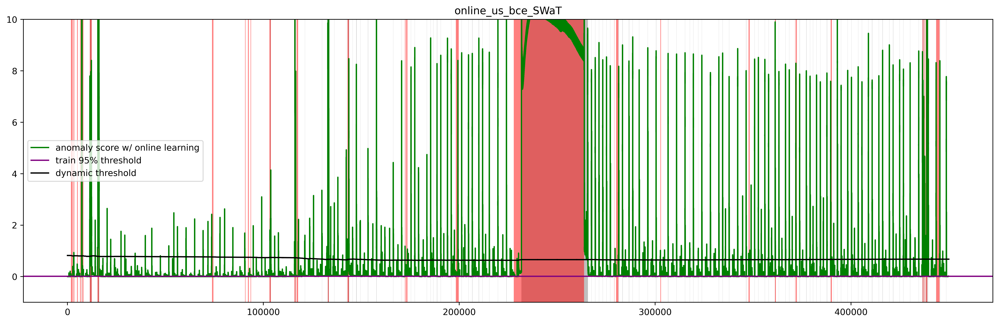

In [246]:
#s, e = 26751, 26851
s, e = 0, -1
plt.figure(figsize=(20, 6), dpi=500)
plt.title(f"online_us_bce_{args.dataset}")
plt.ylim([-1, 10])
#plt.plot(anoscs_prev[s:e], color="blue", label="anomaly score w/o online learning")
plt.plot(anoscs[s:e], color="green", label="anomaly score w/ online learning")
plt.axhline(th_q95, color="purple", label="train 95% threshold")
plt.plot(thrs[s:e], color="black",label="dynamic threshold")

plot_interval(plt, preds.astype(int)[s:e], facecolor="gray", alpha=0.5)
plot_interval(plt, test_y[s:e])
plt.legend()
plt.show()

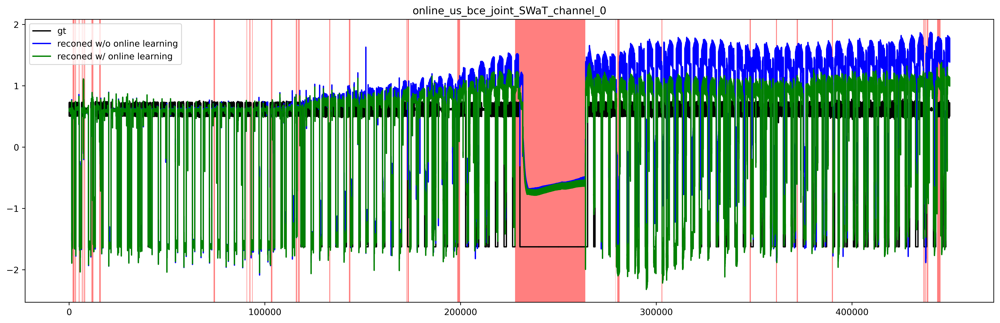

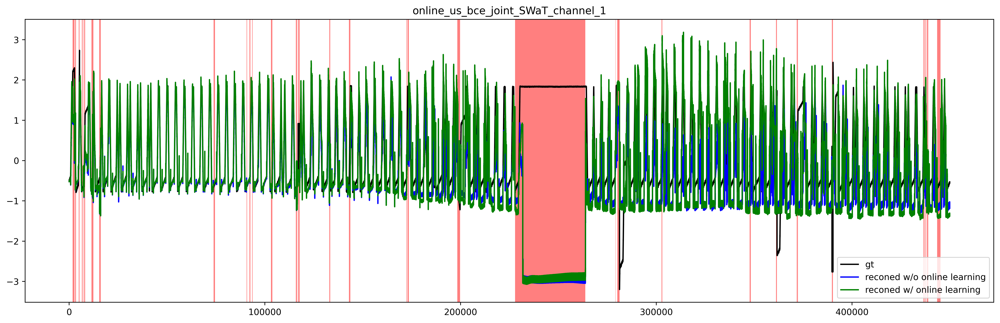

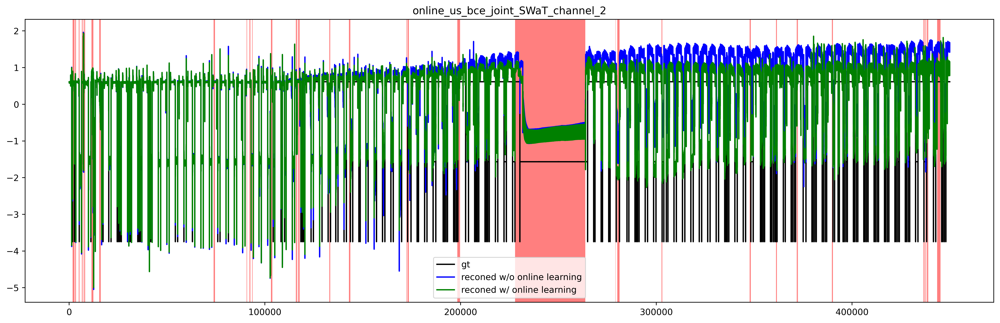

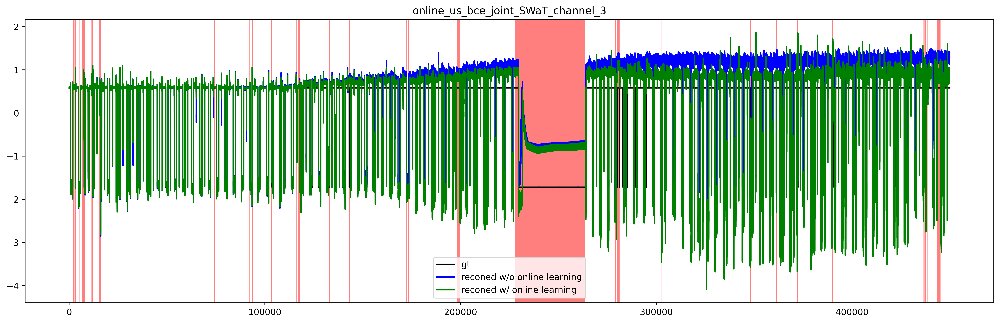

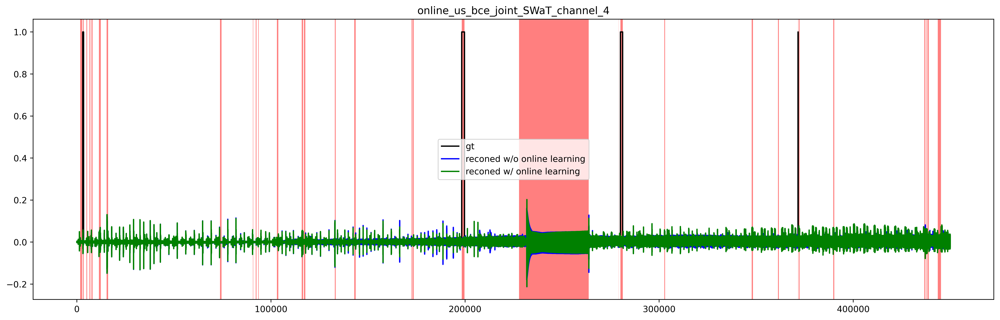

...

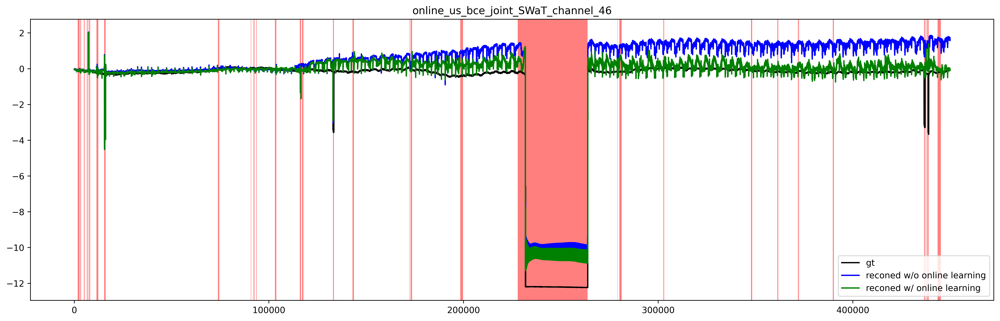

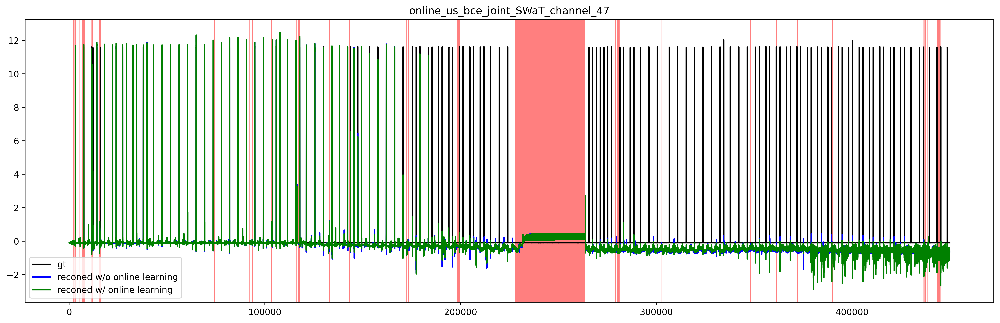

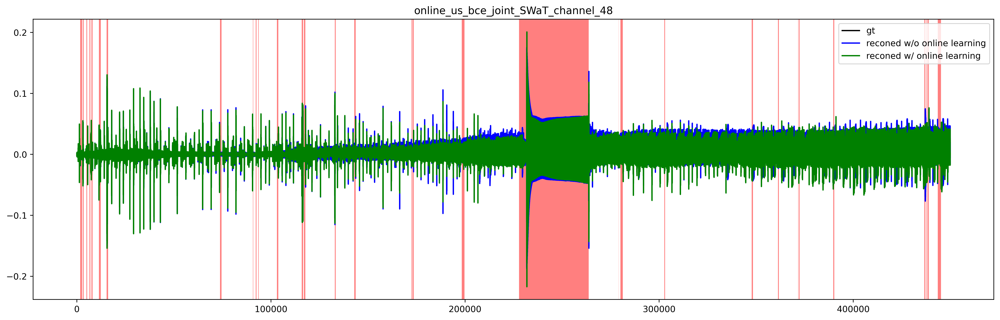

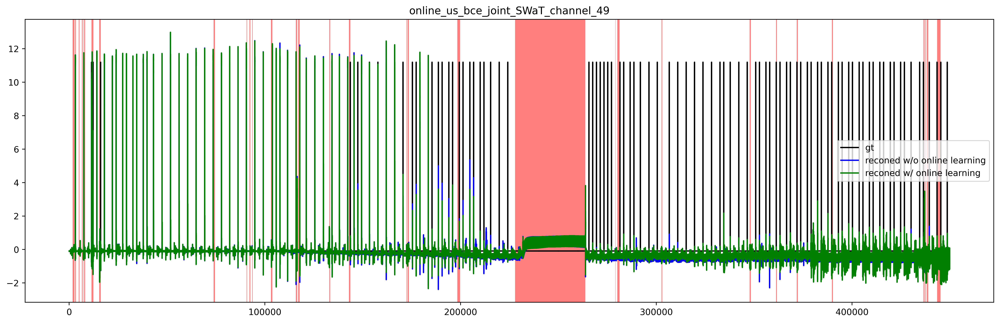

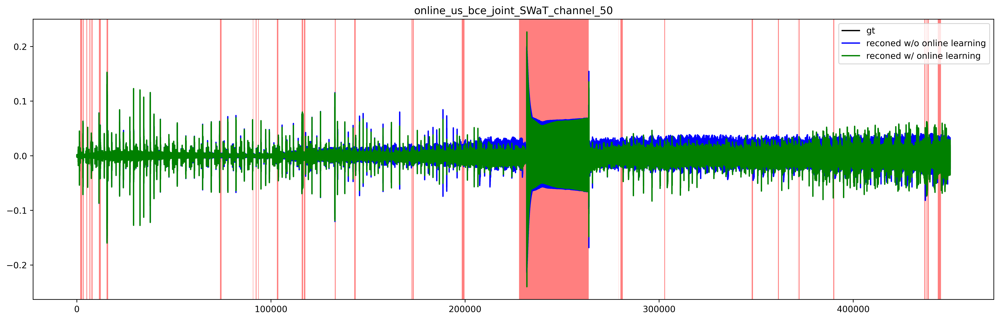

In [198]:
# plot recon
c = 0
for c in range(args.num_channels):
    test_X, test_y = test_dataset.X, test_dataset.y

    B, L, C = Xhats.shape

    plt.figure(figsize=(20, 6), dpi=500)
    plt.title(f"online_us_bce_joint_{args.dataset}_channel_{c}")

    plt.plot(test_X[:, c], color="black", label="gt")
    plt.plot(Xhats_prev[:,:,c].reshape(-1), color="blue", label="reconed w/o online learning")
    plt.plot(Xhats[:,:,c].reshape(-1), color="green", label="reconed w/ online learning")
    plt.legend()
    plot_interval(plt, test_y)

### Just learn normals

In [ ]:
thr = torch.quantile(train_error_dist, 0.95).detach().item()
thr

In [ ]:
tester = MLP_Tester(
    args=args,
    logger=logger,
    train_loader=train_loader,
    test_loader=test_loader,
)
tester.load(os.path.join("./checkpoints/MLP_SWaT", f"best.pth"))

In [ ]:
eval_iterator = tqdm(
    tester.test_loader,
    total=len(tester.test_loader),
    desc="calculating reconstruction errors",
    leave=True
)

lr = 1e-03
TT_optimizer = torch.optim.SGD([p for p in tester.model.parameters()], lr=lr)
bce = torch.nn.BCELoss()

Xs, Xhats = [], []
yhats = []
preds = []
As, thrs =[], []

for i, batch_data in enumerate(eval_iterator):
    X, y = batch_data[0].to(tester.args.device), batch_data[1].to(tester.args.device)
    B, L, C = X.shape
    
    # inference
    Xhat = tester.model(X)
    E = F.mse_loss(Xhat, X, reduction='none')
    A = E.mean(dim=2)
    ytilde = (A > thr).float()
    pred = (A > thr)
    
    # log source model outputs
    Xs.append(X)
    Xhats.append(Xhat.clone().detach())
    As.append(A.clone().detach())
    preds.append(pred.clone().detach())
    thrs.append(thr)
    
    # learn new-normals
    TT_optimizer.zero_grad()
    mask = (ytilde == 0)
    recon_loss = (A*mask).mean()
    recon_loss.backward()
    TT_optimizer.step()
    
Xs = torch.cat(Xs, axis=0).detach().cpu().numpy()    
Xhats = torch.cat(Xhats, axis=0).detach().cpu().numpy()

anoscs = torch.cat(As, axis=0).reshape(-1).detach().cpu().numpy()
thrs = np.repeat(np.array(thrs), args.window_size*args.eval_batch_size)
preds = torch.cat(preds).reshape(-1).detach().cpu().numpy()

In [ ]:
print(test_y.shape, preds.shape)
single_CE = get_summary_stats(test_y, preds)
print(single_CE)

In [ ]:
#s, e = 26751, 26851
s, e = 0, -1
plt.figure(figsize=(20, 6), dpi=500)
plt.title(f"online_us_bce_{args.dataset}")
plt.ylim([-1, 5])
plt.plot(anoscs_prev[s:e], color="blue", label="anomaly score w/o online learning")
plt.plot(anoscs[s:e], color="green", label="anomaly score w/ online learning")
plt.axhline(th_q95, color="purple", label="train 95% threshold")
plt.plot(thrs[s:e], color="black",label="dynamic threshold")

plot_interval(plt, test_y[s:e])
plot_interval(plt, preds.astype(int)[s:e], facecolor="gray", alpha=1)
plt.legend()
plt.show()

In [ ]:
# plot recon
c = 0
for c in range(args.num_channels):
    test_X, test_y = test_dataset.X, test_dataset.y

    B, L, C = Xhats.shape

    plt.figure(figsize=(20, 6), dpi=500)
    plt.title(f"online_us_bce_joint_{args.dataset}_channel_{c}")

    plt.plot(Xhats_prev[:,:,c].reshape(-1), color="blue", label="reconed w/o online learning")
    plt.plot(Xhats[:,:,c].reshape(-1), linewidth=0.5, color="green", label="reconed w/ online learning")
    plt.plot(test_X[:, c], color="black", label="gt")
    plt.legend()
    plot_interval(plt, test_y)
    break

### src-tgt network

In [ ]:
thr = torch.quantile(train_error_dist, 0.95).detach().item()
thr

In [ ]:
tester = MLP_Tester(
    args=args,
    logger=logger,
    train_loader=train_loader,
    test_loader=test_loader,
)
tester.load(os.path.join("./checkpoints/MLP_SWaT", f"best.pth"))


pretrained_model = tester.model
source_model = copy.deepcopy(pretrained_model)
target_model = copy.deepcopy(pretrained_model)
ema_updater = EMAUpdater(source_model, target_model, 0.99)

In [ ]:
eval_iterator = tqdm(
    tester.test_loader,
    total=len(tester.test_loader),
    desc="calculating reconstruction errors",
    leave=True
)

lr = 1e-03
TT_optimizer = torch.optim.SGD([p for p in source_model.parameters()], lr=lr)
bce = torch.nn.BCELoss()

Xs, Xhats = [], []
yhats = []
preds = []
As, thrs =[], []

for i, batch_data in enumerate(eval_iterator):
    X, y = batch_data[0].to(tester.args.device), batch_data[1].to(tester.args.device)
    B, L, C = X.shape
    
    with torch.no_grad():
        Xhat_tgt = target_model(X)
        E_tgt = (Xhat_tgt-X)**2
    Xhat_src = source_model(X)
    E_src = (Xhat_src-X)**2
    A = E_src.mean(dim=2)
    ytilde = (A > thr).float()
    pred = (A > thr)
    
    # log source model outputs
    Xs.append(X)
    Xhats.append(Xhat_src.clone().detach())
    As.append(A.clone().detach())
    preds.append(pred.clone().detach())
    thrs.append(thr)
    
    # learn new-normals
    TT_optimizer.zero_grad()
    mask = (ytilde == 0)
    
    if i>1000:
        flood_loss = torch.clamp(E_src-E_tgt, min=0).mean()
        flood_loss.backward()
    else:
        recon_loss = (A*mask).mean()
        recon_loss.backward()
    TT_optimizer.step()
    
Xs = torch.cat(Xs, axis=0).detach().cpu().numpy()    
Xhats = torch.cat(Xhats, axis=0).detach().cpu().numpy()

anoscs = torch.cat(As, axis=0).reshape(-1).detach().cpu().numpy()
thrs = np.repeat(np.array(thrs), args.window_size*args.eval_batch_size)
preds = torch.cat(preds).reshape(-1).detach().cpu().numpy()

In [ ]:
print(test_y.shape, preds.shape)
single_CE = get_summary_stats(test_y, preds)
print(single_CE)

In [ ]:
#s, e = 26751, 26851
s, e = 0, -1
plt.figure(figsize=(20, 6), dpi=500)
plt.title(f"online_us_bce_{args.dataset}")
plt.ylim([-1, 5])
plt.plot(anoscs_prev[s:e], color="blue", label="anomaly score w/o online learning")
plt.plot(anoscs[s:e], color="green", label="anomaly score w/ online learning")
plt.axhline(th_q95, color="purple", label="train 95% threshold")
plt.plot(thrs[s:e], color="black",label="dynamic threshold")

plot_interval(plt, test_y[s:e])
plot_interval(plt, preds.astype(int)[s:e], facecolor="gray", alpha=1)
plt.legend()
plt.show()

### Single + BCE + Label

In [ ]:
thr = torch.quantile(train_error_dist, 0.95).detach().item()
thr = torch.tensor(thr, requires_grad=True)
thr

In [ ]:
tester = MLP_Tester(
    args=args,
    logger=logger,
    train_loader=train_loader,
    test_loader=test_loader,
)
tester.load(os.path.join("./checkpoints/MLP_PSM", f"best.pth"))

In [ ]:
eval_iterator = tqdm(
    tester.test_loader,
    total=len(tester.test_loader),
    desc="calculating reconstruction errors",
    leave=True
)

lr = 1e-03
TT_optimizer = torch.optim.SGD([thr]+[p for p in tester.model.parameters()], lr=lr)
bce = torch.nn.BCELoss()

Xs, Xhats = [], []
yhats = []
preds = []
As, thrs =[], []

for i, batch_data in enumerate(eval_iterator):
    X, y = batch_data[0].to(tester.args.device), batch_data[1].to(tester.args.device)
    B, L, C = X.shape
    
    # inference
    Xhat = tester.model(X)
    E = F.mse_loss(Xhat, X, reduction='none')
    A = E.mean(dim=2)
    ytilde = (A > thr).float()
    pred = (A > thr)
    
    # log source model outputs
    Xs.append(X)
    Xhats.append(Xhat.clone().detach())
    As.append(A.clone().detach())
    preds.append(pred.clone().detach())
    thrs.append(thr.clone().detach().item())
    
    # learn new-normals and update threshold
    TT_optimizer.zero_grad()
    mask = (y == 0)
    yhat = torch.sigmoid((A - thr))
    cls_loss = bce(yhat, y.float())
    recon_loss = (A * mask).mean()
    loss = recon_loss + cls_loss
    loss.backward()
    TT_optimizer.step()
    
    
Xs = torch.cat(Xs, axis=0).detach().cpu().numpy()    
Xhats = torch.cat(Xhats, axis=0).detach().cpu().numpy()

anoscs = torch.cat(As, axis=0).reshape(-1).detach().cpu().numpy()
thrs = np.repeat(np.array(thrs), args.window_size*args.eval_batch_size)
preds = torch.cat(preds).reshape(-1).detach().cpu().numpy()

In [ ]:
# result summary
print(test_y.shape, preds.shape)
result = get_summary_stats(test_y, preds)
print(result)

In [ ]:
s, e = 0, -1
plt.figure(figsize=(20, 6), dpi=500)
plt.title(f"online_label_bce_joint_{args.dataset}")
plt.ylim([-1, 5])
plt.plot(anoscs_prev[s:e], color="blue", label="anomaly score w/o online learning")
plt.plot(anoscs[s:e], color="green", label="anomaly score w/ online learning")
plt.axhline(th_q95, color="purple", label="train 95% threshold")
plt.plot(thrs[s:e], color="black",label="dynamic threshold")

plot_interval(plt, test_y[s:e])
plot_interval(plt, preds.astype(int)[s:e], facecolor="gray", alpha=0.5)
plt.legend()
plt.show()

In [ ]:
# plot recon
c = 0
for c in range(args.num_channels):
    test_X, test_y = test_dataset.X, test_dataset.y

    B, L, C = Xhats.shape

    plt.figure(figsize=(20, 6), dpi=500)
    plt.title(f"online_us_bce_joint_{args.dataset}_channel_{c}")

    plt.plot(test_X[:, c], color="black", label="gt")
    plt.plot(Xhats_prev[:,:,c].reshape(-1), color="blue", label="reconed w/o online learning")
    plt.plot(Xhats[:,:,c].reshape(-1), linewidth=0.5, color="green", label="reconed w/ online learning")
    plt.legend()
    plot_interval(plt, test_y)